In [1]:
import calendar
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import STL
import dateutil.parser as dparser
sns.set(style="whitegrid")
sns.set_palette("dark")

In [2]:
filename = "./data/train_ini.csv"
train = pd.read_csv(filename)
print(train.shape)
print(train.info())
print(train.head())

(164115, 5)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 164115 entries, 0 to 164114
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         164115 non-null  int64  
 1   Dept          164115 non-null  int64  
 2   Date          164115 non-null  object 
 3   Weekly_Sales  164115 non-null  float64
 4   IsHoliday     164115 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 5.2+ MB
None
   Store  Dept        Date  Weekly_Sales  IsHoliday
0      1     1  2010-02-05      24924.50      False
1      1     1  2010-02-12      46039.49       True
2      1     1  2010-02-19      41595.55      False
3      1     1  2010-02-26      19403.54      False
4      1     1  2010-03-05      21827.90      False


In [3]:
n_stores = train["Store"].nunique()
n_dept = train["Dept"].nunique()
n_weeks = train["Date"].nunique()
n_holidays = train["IsHoliday"].sum()
holidays = train[train["IsHoliday"] == True]["Date"].unique()
w1 = min(train["Date"])
wn = max(train["Date"])
print(f"{n_stores} stores and {n_dept} departments.")
print(f"{n_weeks} weeks from {w1} to {wn}.")
print(f"{n_holidays} holidays.")
print(holidays)


45 stores and 81 departments.
56 weeks from 2010-02-05 to 2011-02-25.
14712 holidays.
['2010-02-12' '2010-09-10' '2010-11-26' '2010-12-31' '2011-02-11']


In [4]:
# Add Year, Month and Week to dataframe
train["DateTime"] = pd.to_datetime(train["Date"], format="%Y-%m-%d")
train["Year"] = train["DateTime"].dt.isocalendar().year
train["Month"] = train["DateTime"].dt.month
train["Month_Name"] = train["Month"].apply(lambda x: calendar.month_abbr[x])
train["Year_Month"] = train["Month_Name"] + "-" + train["Year"].astype(str)
train["Week"] = train["DateTime"].dt.isocalendar().week
# Add IsHolidayMonth to DataFrame
train["IsHolidayMonth"] = False
train.loc[train["Month"].isin([2,9,11,12]), "IsHolidayMonth"] = True

# Add Department and Store as String for Plotting
train["Dept_s"] = train["Dept"].apply(str)
train["Store_s"] = train["Store"].apply(str)
# Add Location as Department / Store combination
train["Location"] = train["Dept"].astype(str) + "-" + train["Store"].astype(str)
# Holidays
train.loc[(train["IsHoliday"]== True) & (train["Date"]=="2010-02-12"), "Holiday"] = "Super Bowl 2010"
train.loc[(train["IsHoliday"]== True) & (train["Date"]=="2011-02-11"), "Holiday"] = "Super Bowl 2011"
train.loc[(train["IsHoliday"]== True) & (train["Date"]=="2010-09-10"), "Holiday"] = "Labor Day"
train.loc[(train["IsHoliday"]== True) & (train["Date"]=="2010-11-26"), "Holiday"] = "Thanksgiving"
train.loc[(train["IsHoliday"]== True) & (train["Date"]=="2010-12-31"), "Holiday"] = "Christmas"
train["Holiday"].fillna("Non-Holiday Week", inplace=True)
print(train.head())


   Store  Dept        Date  Weekly_Sales  IsHoliday   DateTime  Year  Month  \
0      1     1  2010-02-05      24924.50      False 2010-02-05  2010      2   
1      1     1  2010-02-12      46039.49       True 2010-02-12  2010      2   
2      1     1  2010-02-19      41595.55      False 2010-02-19  2010      2   
3      1     1  2010-02-26      19403.54      False 2010-02-26  2010      2   
4      1     1  2010-03-05      21827.90      False 2010-03-05  2010      3   

  Month_Name Year_Month  Week  IsHolidayMonth Dept_s Store_s Location  \
0        Feb   Feb-2010     5            True      1       1      1-1   
1        Feb   Feb-2010     6            True      1       1      1-1   
2        Feb   Feb-2010     7            True      1       1      1-1   
3        Feb   Feb-2010     8            True      1       1      1-1   
4        Mar   Mar-2010     9           False      1       1      1-1   

            Holiday  
0  Non-Holiday Week  
1   Super Bowl 2010  
2  Non-Holiday Week 

In [5]:
# Christmas weeks
d = {"X-Mas": ["2010-12-25","2011-12-25"]}
df = pd.DataFrame(data=d, index=[2010,2011])
df["DateTime"] = pd.to_datetime(df["X-Mas"], format="%Y-%m-%d")
df["Week"] = df["DateTime"].dt.isocalendar().week
print(df)

           X-Mas   DateTime  Week
2010  2010-12-25 2010-12-25    51
2011  2011-12-25 2011-12-25    51


In [17]:
# Department, date, store statistics
depts = train.groupby('Dept')
depts = depts.agg({"Date":"nunique","Store":"nunique"})
pct_dates_missing = round(depts[depts["Date"]<56].shape[0] / depts.shape[0] * 100,2)
pct_stores_missing = round(depts[depts["Store"]<45].shape[0] / depts.shape[0] * 100,2)
print(f"{pct_dates_missing} % of departments have fewer than 56 dates")
print(f"{pct_stores_missing} % of departments have fewer than 45 stores.")



6.17 % of departments have fewer than 56 dates
48.15 % of departments have fewer than 45 stores.


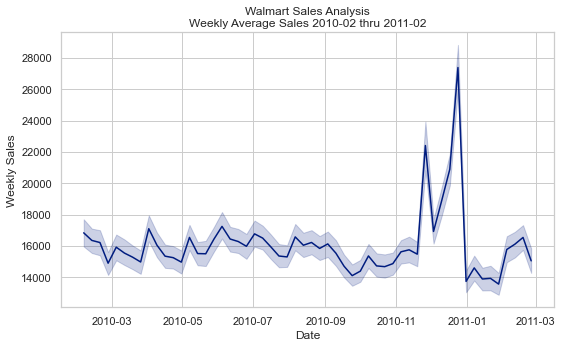

In [106]:
# Weekly Average Sales
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="DateTime", y="Weekly_Sales", data=train, ax=ax)
ax.set(xlabel="Date", ylabel="Weekly Sales", title="Walmart Sales Analysis\nWeekly Average Sales 2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

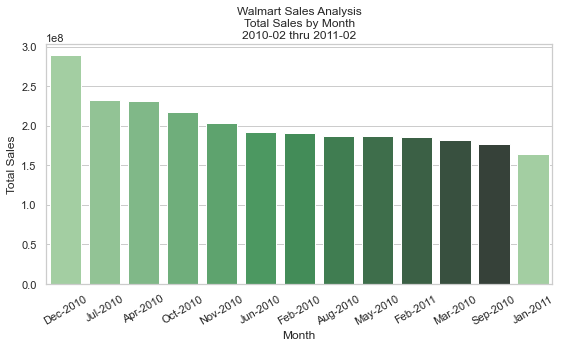

In [107]:
#Total Sales by Month and Year
monthly_sales = train[["Year_Month", "Weekly_Sales"]].groupby(by=["Year_Month"]).sum()
monthly_sales["Pct Sales"] = round(monthly_sales.apply(lambda x: 100*x/float(x.sum())),2)
monthly_sales.columns = ["Monthly Sales", "Pct Sales"]
monthly_sales.sort_values(by=["Monthly Sales"], ascending=False, inplace=True)
monthly_sales.reset_index(inplace=True)

palette = sns.color_palette("Greens_d", 12)
fig, ax = plt.subplots(figsize=(8,5))
sns.barplot(x="Year_Month", y="Monthly Sales", data=monthly_sales, palette=palette)
ax.set(xlabel="Month", ylabel="Total Sales", title="Walmart Sales Analysis\nTotal Sales by Month\n2010-02 thru 2011-02")
sns.set_palette("BuGn", 12)
ax.title.set_size(12)
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

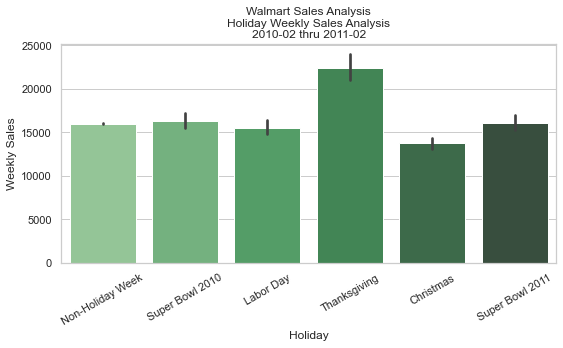

In [108]:
# Holiday vs Non-Holiday Sales
palette = sns.color_palette("Greens_d", 6)
fig, ax = plt.subplots(figsize=(8,5))
sns.barplot(x="Holiday", y="Weekly_Sales", data=train, palette=palette)
ax.set(xlabel="Holiday", ylabel="Weekly Sales", title="Walmart Sales Analysis\nHoliday Weekly Sales Analysis\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()



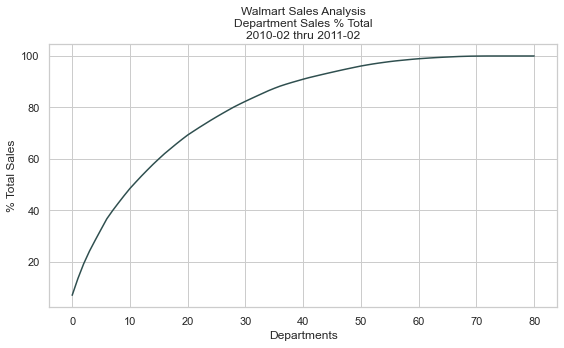

In [109]:
# Cumulative Sales by Department
dept_total_sales = train[["Dept_s", "Weekly_Sales"]].groupby(by=["Dept_s"]).sum()
dept_total_sales.columns = ["Total_Sales"]
dept_total_sales.sort_values(by="Total_Sales", ascending=False, inplace=True)
dept_total_sales["Cumulative"] = dept_total_sales.cumsum(axis=0)
dept_total_sales["Pct_Total"] = dept_total_sales["Cumulative"].apply(lambda x: x * 100 / dept_total_sales["Total_Sales"].sum())
dept_total_sales["Num_Depts"] = np.arange(dept_total_sales.shape[0])
dept_total_sales.reset_index(inplace=True)

palette = sns.color_palette("Blues")
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="Num_Depts", y="Pct_Total", data=dept_total_sales, ax=ax, legend=False, color="darkslategrey")
ax.set(xlabel="Departments", ylabel="% Total Sales", title="Walmart Sales Analysis\nDepartment Sales % Total\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

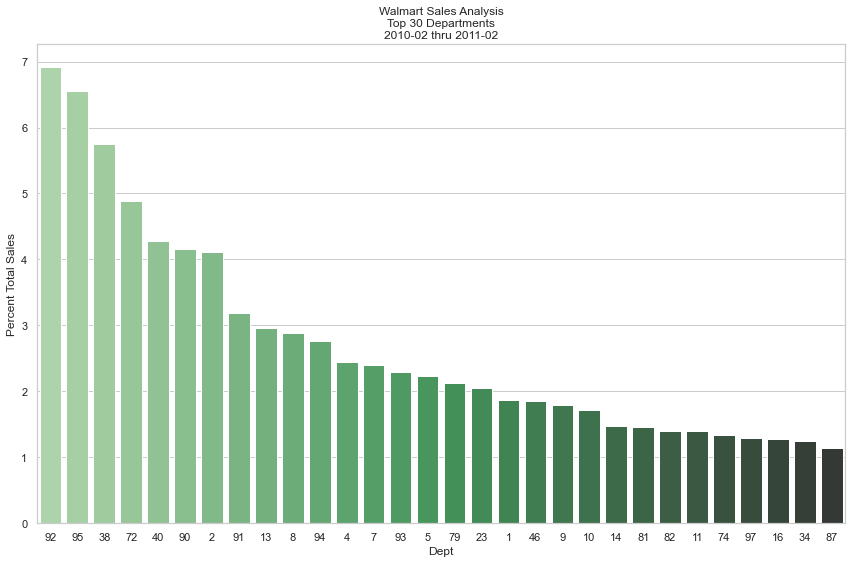

In [110]:
#Top 30 Departments by Total Sales
dept_sales = train[["Dept_s", "Weekly_Sales"]].groupby(by=["Dept_s"]).sum()
dept_sales["Pct Sales"] = round(dept_sales.apply(lambda x: 100*x/float(x.sum())),2)
dept_sales.columns = ["Total Sales", "Pct Sales"]
dept_sales.sort_values(by=["Total Sales"], ascending=False, inplace=True)
dept_sales.reset_index(inplace=True)
top_dept = dept_sales[0:30]

palette = sns.color_palette("Greens_d", 30)
fig, ax = plt.subplots(figsize=(12,8))
sns.barplot(x="Dept_s", y="Pct Sales", data=top_dept, palette=palette)
ax.set(xlabel="Dept", ylabel="Percent Total Sales", title="Walmart Sales Analysis\nTop 30 Departments\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

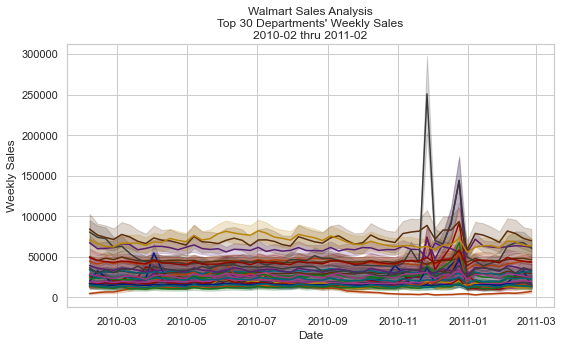

In [111]:
# Top 30 Departments
top_30 = train[train["Dept_s"].isin(top_dept["Dept_s"])]
palette = sns.color_palette("dark", 30)
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="DateTime", y="Weekly_Sales", hue="Dept_s", data=top_30, ax=ax, legend=False, palette=palette)
ax.set(xlabel="Date", ylabel="Weekly Sales", title="Walmart Sales Analysis\nTop 30 Departments' Weekly Sales\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

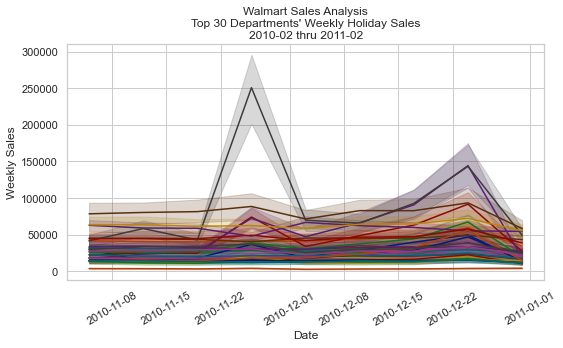

In [112]:
# Top 30 Departments Holiday Earnings
top_30_holiday = top_30[top_30["Month"].isin([11,12])]
palette = sns.color_palette("dark", 30)
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="DateTime", y="Weekly_Sales", hue="Dept_s", data=top_30_holiday, ax=ax, legend=False, palette=palette)
ax.set(xlabel="Date", ylabel="Weekly Sales", title="Walmart Sales Analysis\nTop 30 Departments' Weekly Holiday Sales\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

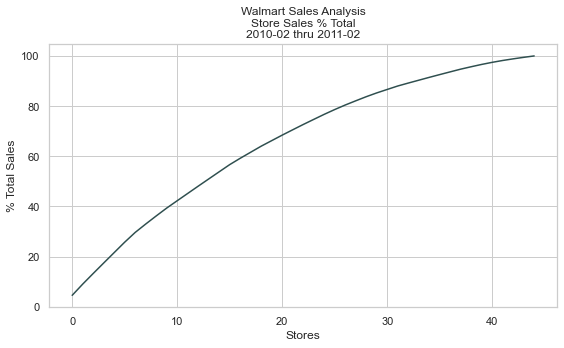

In [113]:
# Cumulative Sales by Store
store_total_sales = train[["Store_s", "Weekly_Sales"]].groupby(by=["Store_s"]).sum()
store_total_sales.columns = ["Total_Sales"]
store_total_sales.sort_values(by="Total_Sales", ascending=False, inplace=True)
store_total_sales["Cumulative"] = store_total_sales.cumsum(axis=0)
store_total_sales["Pct_Total"] = store_total_sales["Cumulative"].apply(lambda x: x * 100 / store_total_sales["Total_Sales"].sum())
store_total_sales["Num_Stores"] = np.arange(store_total_sales.shape[0])
store_total_sales.reset_index(inplace=True)

palette = sns.color_palette("Blues")
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="Num_Stores", y="Pct_Total", data=store_total_sales, ax=ax, legend=False, color="darkslategrey")
ax.set(xlabel="Stores", ylabel="% Total Sales", title="Walmart Sales Analysis\nStore Sales % Total\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

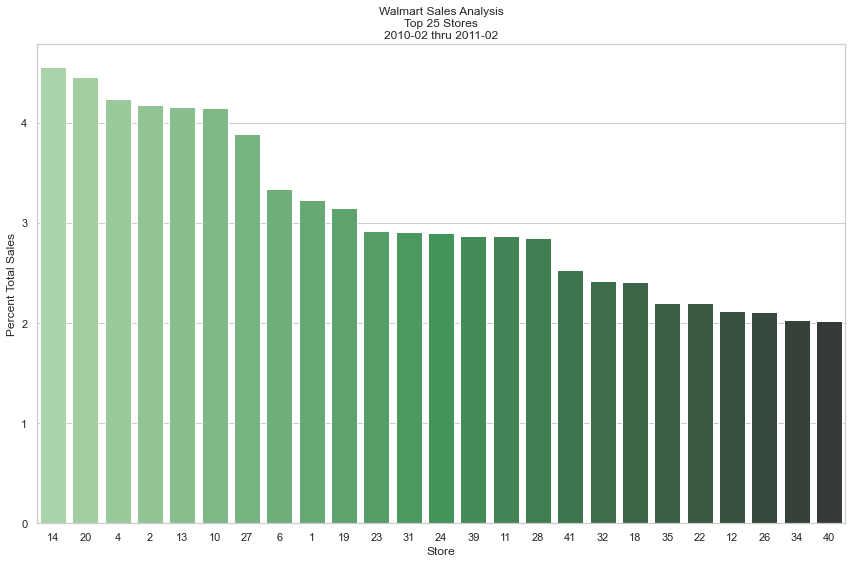

In [115]:
#Top Stores by Total Sales
store_sales = train[["Store_s", "Weekly_Sales"]].groupby(by=["Store_s"]).sum()
store_sales["Pct Sales"] = round(store_sales.apply(lambda x: 100*x/float(x.sum())),2)
store_sales.columns = ["Total Sales", "Pct Sales"]
store_sales.sort_values(by=["Total Sales"], ascending=False, inplace=True)
store_sales.reset_index(inplace=True)
top_stores = store_sales[0:25]

palette = sns.color_palette("Greens_d", 25)
fig, ax = plt.subplots(figsize=(12,8))
sns.barplot(x="Store_s", y="Pct Sales", data=top_stores, palette=palette)
ax.set(xlabel="Store", ylabel="Percent Total Sales", title="Walmart Sales Analysis\nTop 25 Stores\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

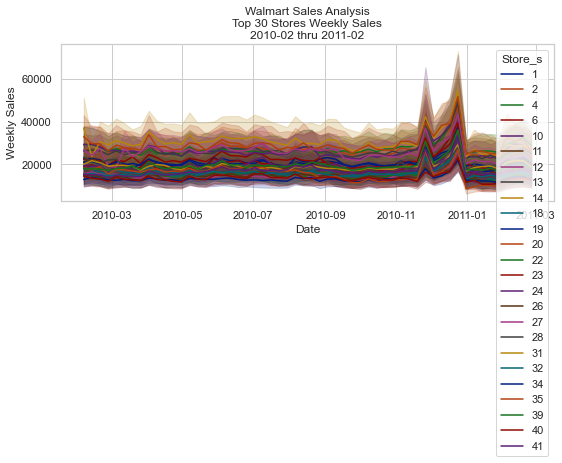

In [117]:
# Plot Time Series for Top 25 Stores
top_store_sales = train[train["Store_s"].isin(top_stores["Store_s"])]
palette = sns.color_palette("dark", 25)
fig, ax = plt.subplots(figsize=(8,5))
sns.lineplot(x="DateTime", y="Weekly_Sales", hue="Store_s", data=top_store_sales, ax=ax,  palette=palette, legend=False)
ax.set(xlabel="Date", ylabel="Weekly Sales", title="Walmart Sales Analysis\nTop 25 Stores Weekly Sales\n2010-02 thru 2011-02")
ax.title.set_size(12)
plt.tight_layout()
plt.show()

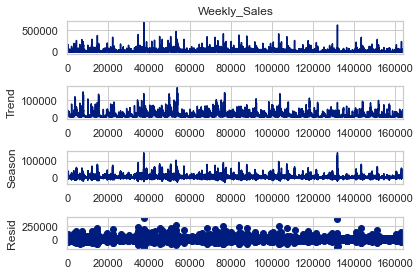

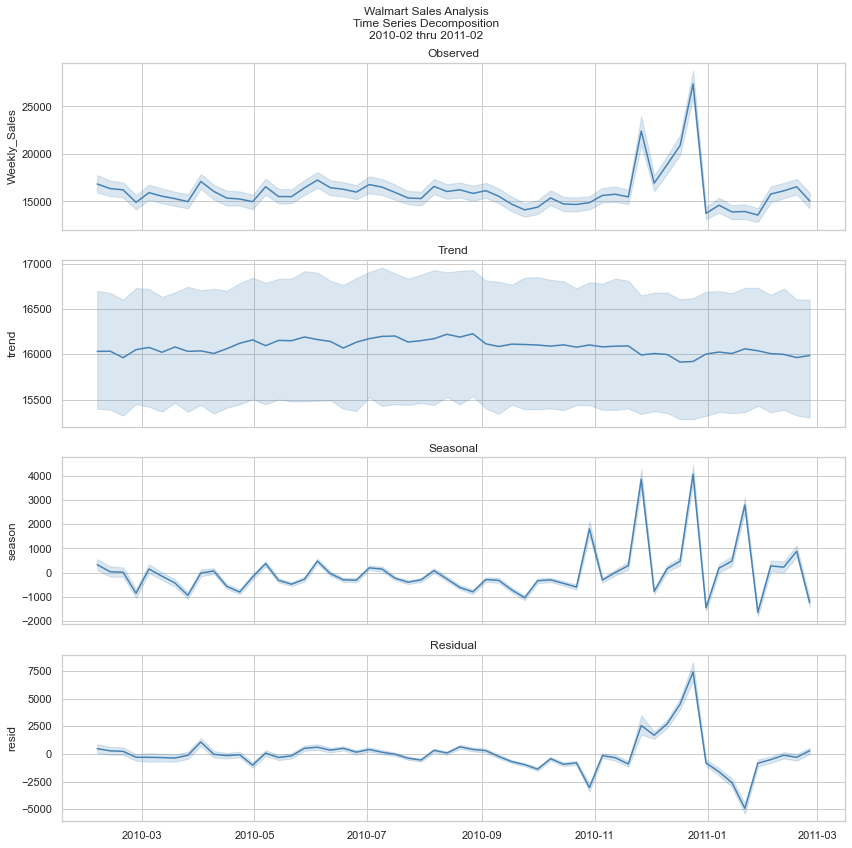

In [135]:
stl = STL(train["Weekly_Sales"], period=52)
tsd = stl.fit()
tsd.plot()
resid = tsd.resid.to_frame().reset_index()
resid["DateTime"] = train["DateTime"]
trend = tsd.trend.to_frame().reset_index()
trend["DateTime"] = train["DateTime"]
season = tsd.seasonal.to_frame().reset_index()
season["DateTime"] = train["DateTime"]
## Figure
fig, axes = plt.subplots(nrows=4,ncols=1,figsize=(12,12), sharex=True)

sns.lineplot(x="DateTime", y="Weekly_Sales", data=train, ax=axes[0], legend=False, color="steelblue")
sns.lineplot(x="DateTime", y="trend", data=trend, ax=axes[1], legend=False, color="steelblue")
sns.lineplot(x="DateTime", y="season", data=season, ax=axes[2], legend=False, color="steelblue")
sns.lineplot(x="DateTime", y="resid", data=resid, ax=axes[3], legend=False,
color="steelblue")

# Axis Labels
axes[0].set(xlabel=None)
axes[1].set(xlabel=None)
axes[2].set(xlabel=None)
axes[3].set(xlabel=None)

axes[0].set_title("Observed")
axes[1].set_title("Trend")
axes[2].set_title("Seasonal")
axes[3].set_title("Residual")

fig.suptitle("Walmart Sales Analysis\nTime Series Decomposition\n2010-02 thru 2011-02", fontsize=12)
plt.tight_layout()
plt.show()